### Multiple Dispatch helps make Julia fast. <br> It also makes Julia extensible, programmable, and downright fun to play with. <br> It may just be a breakthrough for parallel computation...

1. Roman Numeral Example
2. Function Example
3. Parallel Computing Example

## 1. Roman Numeral Example (just for fun)

In [1]:
type Roman 
    n::Int
end

# Cool roman numeral printing magic (0:9 for demo only)
import Base: promote_rule, convert, show
Base.show(io::IO, r::Roman) = print(io,r.n%10==0?'0':'ⅰ'+r.n%10-1)

[Roman(1) Roman(2) Roman(5) Roman(9) ]     #Exercise: make work past single digits

1×4 Array{Roman,2}:
 ⅰ  ⅱ  ⅴ  ⅸ

In [9]:
;pwd

/Users/alanedelman/git/18.337_2016/lectures/lecture_2_09_12


In [2]:
import Base.*
*(i::Roman,j::Roman)  = Roman(i.n*j.n)                    # Multiply like a Roman
*(i::Number,j::Roman) = eye(i)*j.n                        # Multiply like a matrix constructor
*(i::Roman,j::Number) = join(['☺' for k=1:(i.n)*j])     # Multiply like a kid

* (generic function with 154 methods)

In [3]:
[Roman(2)*Roman(3)  Roman(3)^2 ]                        # WOW! Squaring just worked

1×2 Array{Roman,2}:
 ⅵ  ⅸ

In [4]:
7*Roman(4)                                             # Multiply like a matrix constructor

7×7 Array{Float64,2}:
 4.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  4.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  4.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  4.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  4.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  4.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  4.0

In [9]:
Roman(10)*4                                            # Multiply like a kid

"☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺☺"

## 2. Function Example (glimpse of why multiple dispatch is useful)

In [5]:
import Base.*
*(α::Number,   g::Function) = x -> α * g(x)                # Scalar times function
*(f::Function, λ::Number)   = x -> f(λ * x)               # Scale the argument
*(f::Function, g::Function) = x -> f(g(x))             # Function Composition

* (generic function with 157 methods)

In [6]:
using Plots

In [19]:
plotlyjs()

Plots.PlotlyJSBackend()


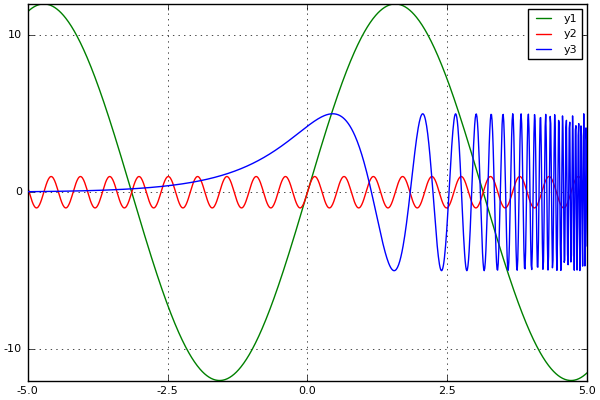

In [7]:
xx = -5:0.01:5

plot(12*sin, xx, color=:green)
plot!(sin*12, xx, c=:red)
plot!(5*sin*exp, xx, c=:blue)



In [ ]:
Pkg.add("PlotlyJS")

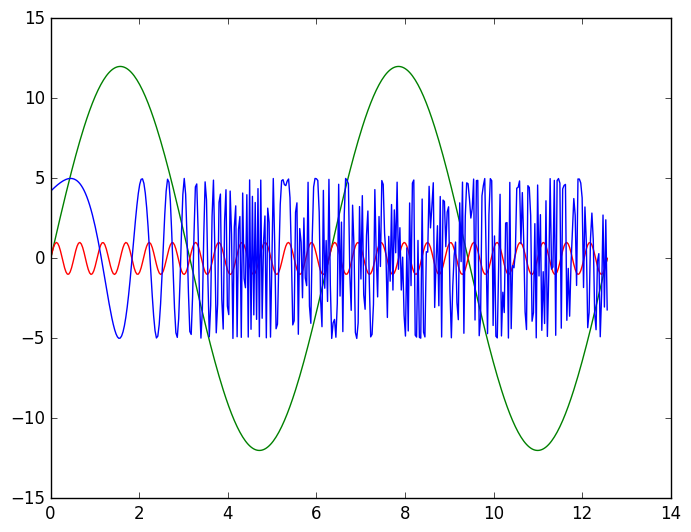

  likely near /Users/alanedelman/.julia/v0.5/IJulia/src/kernel.jl:35
in show at /Users/alanedelman/.julia/v0.5/PyPlot/src/PyPlot.jl


1-element Array{Any,1}:
 PyObject <matplotlib.lines.Line2D object at 0x32ca68c10>

In [24]:
x=π*(0:.01:4)

plot(x,(12*sin)(x),"g")
plot(x,(sin*12)(x),"r")
plot(x,(5*sin*exp)(x),"b")

<img src="https://lh4.googleusercontent.com/--z5eKJbB7sg/UffjL1iAd4I/AAAAAAAABOc/S_wDVyDOBfQ/gauss.jpg">

###  "Sin^2 phi is odious to me, even though Laplace made use of it; should  it be feared that sin^2 phi might become ambiguous, which would perhaps  never occur, or at most very rarely when speaking of sin(phi^2), well  then, let us write (sin phi)^2, but not sin^2 phi, which by analogy  should signify sin(sin phi)." -- Gauss

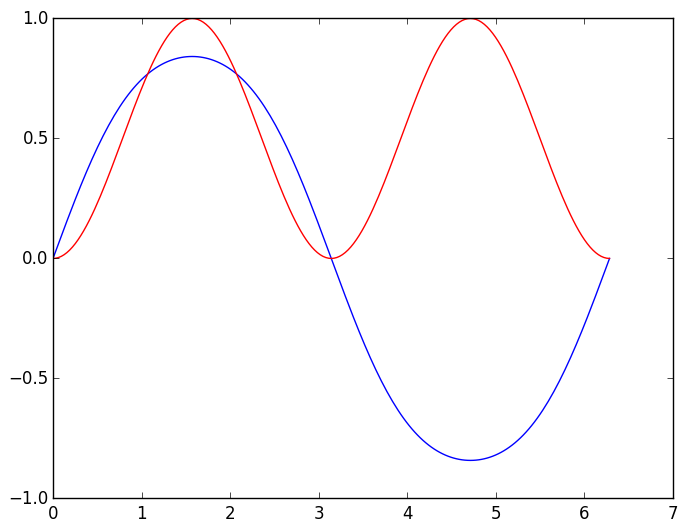

1-element Array{Any,1}:
 PyObject <matplotlib.lines.Line2D object at 0x3221a9ed0>

In [18]:
x=(0:.01:2)*pi;
plot(x,(sin^2)(x),"b")     # Squaring just works, y=sin(sin(x)), Gauss would be pleased!
plot(x,sin(x).^2,"r")         

## 3. Parallel Computing Examples (How did we live without it!!??)

In [57]:
cumprod(1:10)'      #Prefix product gives factorials

1x10 Array{Int64,2}:
 1  2  6  24  120  720  5040  40320  362880  3628800

In [58]:
function prefix_serial(y,*)
    for i in 2:length(y)
        y[i]=y[i-1]*y[i]
    end
    y
end

prefix_serial (generic function with 1 method)

In [59]:
prefix_serial([1:10],*)'

1x10 Array{Int64,2}:
 1  2  6  24  120  720  5040  40320  362880  3628800

In [60]:
prefix_serial([1:10],+)'

1x10 Array{Int64,2}:
 1  3  6  10  15  21  28  36  45  55

In [61]:
prefix_serial([1:10],min)'

1x10 Array{Int64,2}:
 1  1  1  1  1  1  1  1  1  1

In [62]:
A=[rand(1:3,2,2) for i=1:4]

4-element Array{Array{Int64,2},1}:
 2x2 Array{Int64,2}:
 2  3
 1  2
 2x2 Array{Int64,2}:
 1  3
 1  1
 2x2 Array{Int64,2}:
 3  2
 1  1
 2x2 Array{Int64,2}:
 2  2
 1  2

In [63]:
prefix_serial(A,*)

4-element Array{Array{Int64,2},1}:
 2x2 Array{Int64,2}:
 2  3
 1  2    
 2x2 Array{Int64,2}:
 5  9
 3  5    
 2x2 Array{Int64,2}:
 24  19
 14  11
 2x2 Array{Int64,2}:
 67  86
 39  50

In [65]:
prefix_serial(A,kron)

4-element Array{Array{Int64,2},1}:
 2x2 Array{Int64,2}:
 2  3
 1  2                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [28]:
# staged prefix (example with 8 elements)

In [66]:
function prefix8(y,*)
    if length(y)!=8; error("length 8 only"); end
    for i in [2,4,6,8]; y[i]=y[i-1]*y[i]; end
    for i in [  4,  8]; y[i]=y[i-2]*y[i]; end
    for i in [      8]; y[i]=y[i-4]*y[i]; end
    for i in [    6  ]; y[i]=y[i-2]*y[i]; end
    for i in [ 3,5,7 ]; y[i]=y[i-1]*y[i]; end
    y
end

prefix8 (generic function with 1 method)

In [67]:
prefix8([1:8],*)'

1x8 Array{Int64,2}:
 1  2  6  24  120  720  5040  40320

In [68]:
addprocs(7)

7-element Array{Int64,1}:
 14
 15
 16
 17
 18
 19
 20

### @spawnat : One of many parallel programming primitives in Julia

In [32]:
r=@spawnat 3 x=randn(4,4)    # Execute on processor 3, return a pointer to the answer

RemoteRef{Channel{Any}}(3,1,8)

In [33]:
fetch(r)

4x4 Array{Float64,2}:
  0.164581  -0.00814447  -0.965827   0.584241
 -0.916758   0.0056406   -0.348977  -0.444264
 -0.340002  -0.643528     1.17386   -1.03533 
 -2.06345   -0.336684     2.38098   -0.583298

In [34]:
*(r1::RemoteRef,r2::RemoteRef)=@spawnat r2.where fetch(r1)*fetch(r2)

* (generic function with 149 methods)

In [35]:
addprocs(5)

5-element Array{Int64,1}:
  9
 10
 11
 12
 13

In [36]:
@spawnat 3 x=randn(2000,2000)

RemoteRef{Channel{Any}}(3,1,15)

In [37]:
@time @sync  @spawnat 1 fetch(RemoteRef(3,1,23));

LoadError: LoadError: MethodError: `convert` has no method matching convert(::Type{RemoteRef{T<:AbstractChannel}}, ::Int64, ::Int64, ::Int64)
This may have arisen from a call to the constructor RemoteRef{T<:AbstractChannel}(...),
since type constructors fall back to convert methods.
Closest candidates are:
  RemoteRef(::Integer)
  RemoteRef(!Matched::Function, ::Integer)
  call{T}(::Type{T}, ::Any)
  ...
 in call at /Applications/Julia-0.4.3.app/Contents/Resources/julia/lib/julia/sys.dylib
 in anonymous at multi.jl:1364
 in run_work_thunk at multi.jl:651
 in run_work_thunk at multi.jl:660
 in anonymous at task.jl:58
while loading In[37], in expression starting on line 422

### The above makes the prefix code parallel 

In [38]:
A=[@spawnat i randn(5000,5000) for i=1:8]

8-element Array{Any,1}:
 RemoteRef{Channel{Any}}(1,1,17)
 RemoteRef{Channel{Any}}(2,1,18)
 RemoteRef{Channel{Any}}(3,1,19)
 RemoteRef{Channel{Any}}(4,1,20)
 RemoteRef{Channel{Any}}(5,1,21)
 RemoteRef{Channel{Any}}(6,1,22)
 RemoteRef{Channel{Any}}(7,1,23)
 RemoteRef{Channel{Any}}(8,1,24)

In [39]:
@time @sync prefix8(A,*)

 36

8-element Array{Any,1}:
 RemoteRef{Channel{Any}}(1,1,17)
 RemoteRef{Channel{Any}}(2,1,25)
 RemoteRef{Channel{Any}}(3,1,33)
 RemoteRef{Channel{Any}}(4,1,29)
 RemoteRef{Channel{Any}}(5,1,34)
 RemoteRef{Channel{Any}}(6,1,32)
 RemoteRef{Channel{Any}}(7,1,35)
 RemoteRef{Channel{Any}}(8,1,31)

In [40]:
nnz(A)

LoadError: LoadError: MethodError: `nnz` has no method matching nnz(::Array{Any,1})
while loading In[40], in expression starting on line 1

In [41]:
[1 1 ; 1 1]^6

2x2 Array{Int64,2}:
 32  32
 32  32

.251245 seconds (319.85 k allocations: 13.529 MB)


In [24]:
Pkg.add("ArrayFire")

INFO: Nothing to be done
INFO: METADATA is out-of-date — you may not have the latest version of ArrayFire
INFO: Use `Pkg.update()` to get the latest versions of your packages


In [25]:
using ArrayFire

In [35]:
n=1000
x= rand(Float32,n,n)
@time x^2
n=2000
x= rand(Float32,n,n)
@time x^2

  0.013145 seconds (7 allocations: 3.815 MB)
  0.077858 seconds (7 allocations: 15.259 MB)


2000×2000 Array{Float32,2}:
 501.568  505.007  493.5    489.321  483.159  491.067  502.339  502.968  490.48   498.587  503.773  496.578  490.497  498.606  500.945  494.567  501.582  492.233  488.78   506.491  499.789  499.69   487.815  513.857  490.942  493.945  499.947  504.38   509.958  504.185  497.1    485.075  484.394  507.857  498.877  493.21   490.975  507.568  489.001  495.171  497.583  489.294  494.672  487.44   494.293  501.744  491.608  502.76   506.75   486.294  489.033  501.389  498.918  483.14   501.218  485.517  493.799  499.566  495.578  481.573  519.551  499.361  486.367  501.758  500.698  503.687  501.605  500.521  502.544  494.552  502.441  500.183  496.118  505.158  501.702  492.654  494.144  490.848  492.749  489.499  500.488  495.738  494.493  506.913  496.574  502.149  488.424  497.986  491.03   490.422  493.631  499.741  486.781  499.032  504.398  517.454  495.336  495.468  488.938  475.754  489.581  499.469  494.066  487.2    488.872  487.881  495.164  508.171 

In [31]:
xx = AFArray(x);
Array(xx)

5×5 Array{Float32,2}:
 0.72396   0.995012  0.609791  0.435998  0.420552 
 0.260661  0.26281   0.21193   0.230033  0.0686759
 0.63544   0.413772  0.206971  0.470279  0.416015 
 0.77872   0.610541  0.506196  0.344222  0.642868 
 0.18641   0.245075  0.457551  0.961487  0.63124  

In [36]:
1+1

2